<a href="https://colab.research.google.com/github/yeray142/AIML_project/blob/master/notebooks/eda/EDA_jjo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ML4AI | EDA 

### Set up for EDA

##### Library

In [1]:
import pandas as pd

In [2]:
# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib as mpl

mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [3]:
#!pip install -U pandas_profiling
import pandas_profiling as Profiling

In [14]:
from sklearn.preprocessing import OrdinalEncoder, StandardScaler

## **EDA with CODE**

#### Data Load

In [4]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [5]:
df_train = pd.read_csv("/content/drive/MyDrive/ML4AI/processed_train_code.csv")
df_test = pd.read_csv("/content/drive/MyDrive/ML4AI/processed_test_code.csv")

In [6]:
df_train = df_train.drop(['Unnamed: 0'], axis=1)
df_test = df_test.drop(['index'],axis =1)

### Data EDA

#### **Basic EDA**

In [7]:
df_train.head()

,gender,car,reality,income_total,income_type,edu_type,family_type,house_type,work_phone,home_phone,...,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
0,F,N,N,202500.0,Commercial associate,Higher education,Married,Municipal apartment,0,0,...,38,7.0,1.0,12,0.0,0.0,25,6.0,0.0,101250.0
1,F,N,Y,247500.0,Commercial associate,Secondary / secondary special,Civil marriage,House / apartment,0,0,...,31,7.0,1.0,4,3.0,0.0,26,4.0,1.0,82500.0
2,M,Y,Y,450000.0,Working,Higher education,Married,House / apartment,0,1,...,52,0.0,2.0,12,3.0,1.0,40,8.0,1.0,225000.0
3,F,N,Y,202500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,0,1,...,41,10.0,3.0,5,9.0,2.0,35,1.0,0.0,101250.0
4,F,Y,Y,157500.0,State servant,Higher education,Married,House / apartment,0,0,...,41,9.0,0.0,5,10.0,0.0,35,11.0,3.0,78750.0


In [8]:
df_test.head()

,gender,car,reality,income_total,income_type,edu_type,family_type,house_type,work_phone,home_phone,...,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
0,M,Y,N,112500.0,Pensioner,Secondary / secondary special,Civil marriage,House / apartment,0,1,...,60,1.0,1.0,0,0.0,0.0,60,1.0,1.0,56250.0
1,F,N,Y,135000.0,State servant,Higher education,Married,House / apartment,0,1,...,51,8.0,1.0,23,1.0,2.0,28,7.0,2.0,67500.0
2,F,N,Y,69372.0,Working,Secondary / secondary special,Married,House / apartment,1,1,...,43,1.0,1.0,0,7.0,3.0,42,6.0,2.0,34686.0
3,M,Y,N,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,1,0,...,52,6.0,0.0,6,0.0,1.0,45,5.0,3.0,56250.0
4,F,Y,Y,225000.0,State servant,Higher education,Married,House / apartment,1,0,...,48,6.0,2.0,25,0.0,0.0,23,5.0,1.0,112500.0


In [9]:
df_train.describe()

,income_total,work_phone,home_phone,email,family_size,begin_month,credit,days_unemployed,income_unemployed,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
count,2.481700e+04,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.000000,24817.00000,24817.000000,24817.000000
mean,1.868744e+05,0.225249,0.294274,0.091510,2.199057,26.054318,1.514325,13753.015514,15.516610,43.194907,5.469920,1.497159,5.608978,4.580932,1.261071,37.174235,5.42620,1.514889,100744.732110
std,1.008656e+05,0.417754,0.455725,0.288339,0.919132,16.532853,0.704571,4867.849160,10.239055,11.523499,3.455598,1.117819,6.429011,3.724893,1.170015,13.337850,3.41686,1.125090,72544.069854
min,2.700000e+04,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,6547.000000,1.268406,21.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.00000,0.000000,5625.000000
25%,1.215000e+05,0.000000,0.000000,0.000000,2.000000,12.000000,1.000000,9671.000000,8.573070,34.000000,2.000000,0.000000,1.000000,1.000000,0.000000,26.000000,2.00000,0.000000,56250.000000
50%,1.575000e+05,0.000000,0.000000,0.000000,2.000000,24.000000,2.000000,12689.000000,13.401499,42.000000,5.000000,2.000000,4.000000,4.000000,1.000000,34.000000,5.00000,2.000000,78750.000000
75%,2.250000e+05,0.000000,1.000000,0.000000,3.000000,39.000000,2.000000,16952.000000,19.822541,53.000000,9.000000,2.000000,8.000000,8.000000,2.000000,46.000000,8.00000,3.000000,123750.000000
max,1.575000e+06,1.000000,1.000000,1.000000,20.000000,60.000000,2.000000,25152.000000,205.533081,68.000000,11.000000,3.000000,43.000000,11.000000,3.000000,68.000000,11.00000,3.000000,900000.000000


In [10]:
df_test.describe()

,income_total,work_phone,home_phone,email,family_size,begin_month,days_unemployed,income_unemployed,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
count,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,1.850433e+05,0.227600,0.296300,0.085600,2.202700,26.272400,13815.419700,15.311681,43.384300,5.520400,1.522900,5.628000,4.535000,1.274400,37.346000,5.427500,1.509000,99166.641975
std,1.015398e+05,0.419304,0.456648,0.279786,0.898272,16.348557,4880.371625,10.324694,11.501663,3.432486,1.107338,6.392034,3.697261,1.176539,13.373009,3.427757,1.129002,71309.514531
min,2.700000e+04,0.000000,0.000000,0.000000,1.000000,0.000000,6548.000000,1.268406,20.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,0.000000,9000.000000
25%,1.215000e+05,0.000000,0.000000,0.000000,2.000000,12.000000,9729.000000,8.400747,34.000000,3.000000,1.000000,1.000000,1.000000,0.000000,26.000000,2.000000,0.000000,54000.000000
50%,1.575000e+05,0.000000,0.000000,0.000000,2.000000,25.000000,12744.500000,13.172820,42.000000,5.000000,2.000000,4.000000,4.000000,1.000000,34.000000,5.000000,2.000000,78750.000000
75%,2.250000e+05,0.000000,1.000000,0.000000,3.000000,39.000000,17152.250000,19.691304,53.000000,9.000000,3.000000,8.000000,8.000000,2.000000,46.000000,8.000000,3.000000,123750.000000
max,1.575000e+06,1.000000,1.000000,1.000000,7.000000,60.000000,25152.000000,205.533081,68.000000,11.000000,3.000000,42.000000,11.000000,3.000000,68.000000,11.000000,3.000000,900000.000000


#### More detailed EDA by Profiling

In [11]:
Profiling.ProfileReport(df_train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### **EDA with scaled and labeled dataset by Visualization**

\- For all columns contained categorical column and numeric column, we need to pre-process process with columns.

In [15]:
num_col = df_train.dtypes[df_train.dtypes != "object"].index.tolist()
num_col.remove('credit')

cat_col = df_train.dtypes[df_train.dtypes == "object"].index.tolist()

# StandardScaler
scaler = StandardScaler()
df_train[num_col] = scaler.fit_transform(df_train[num_col])
df_test[num_col] = scaler.fit_transform(df_test[num_col])

# OrdinalEncoding
Encoder = OrdinalEncoder()
df_train[cat_col] = Encoder.fit_transform(df_train[cat_col], df_train['credit'])
df_test[cat_col] = Encoder.fit_transform(df_test[cat_col])

In [16]:
corr_df = df_train.corr()
corr_df = corr_df.apply(lambda x: round(x ,2))

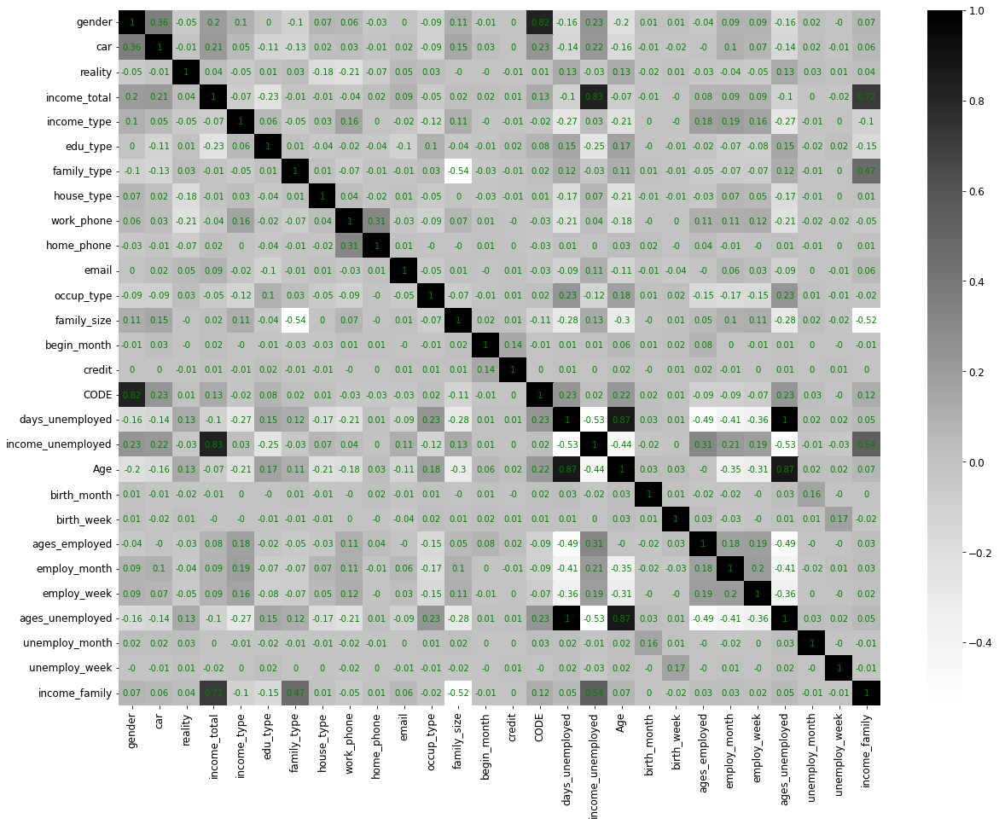

In [19]:
fig, ax = plt.subplots(figsize=(20,15))

ax = sns.heatmap(corr_df, annot=True, annot_kws=dict(color='g'), cmap='Greys')
plt.show()

## **EDA without CODE**

#### Data Load

In [20]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [21]:
df_train = pd.read_csv("/content/drive/MyDrive/ML4AI/processed_train.csv")
df_test = pd.read_csv("/content/drive/MyDrive/ML4AI/processed_test.csv")

In [22]:
df_train = df_train.drop(['Unnamed: 0'], axis=1)
df_test = df_test.drop(['index'],axis =1)

### Data EDA

#### **Basic EDA**

In [23]:
df_train.head()

,gender,car,reality,income_total,income_type,edu_type,family_type,house_type,work_phone,home_phone,...,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
0,F,N,N,202500.0,Commercial associate,Higher education,Married,Municipal apartment,0,0,...,38,7.0,1.0,12,0.0,0.0,25,6.0,0.0,101250.0
1,F,N,Y,202500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,0,1,...,41,10.0,3.0,5,9.0,2.0,35,1.0,0.0,101250.0
2,F,Y,Y,157500.0,State servant,Higher education,Married,House / apartment,0,0,...,41,9.0,0.0,5,10.0,0.0,35,11.0,3.0,78750.0
3,F,N,Y,270000.0,Working,Secondary / secondary special,Married,House / apartment,0,0,...,36,3.0,0.0,13,10.0,1.0,23,4.0,2.0,67500.0
4,F,N,N,315000.0,Working,Secondary / secondary special,Separated,House / apartment,0,0,...,48,9.0,2.0,5,5.0,2.0,42,3.0,3.0,315000.0


In [24]:
df_test.head()

,gender,car,reality,income_total,income_type,edu_type,family_type,house_type,work_phone,home_phone,...,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
0,M,Y,N,112500.0,Pensioner,Secondary / secondary special,Civil marriage,House / apartment,0,1,...,60,1.0,1.0,0,0.0,0.0,60,1.0,1.0,56250.0
1,F,N,Y,135000.0,State servant,Higher education,Married,House / apartment,0,1,...,51,8.0,1.0,23,1.0,2.0,28,7.0,2.0,67500.0
2,F,N,Y,69372.0,Working,Secondary / secondary special,Married,House / apartment,1,1,...,43,1.0,1.0,0,7.0,3.0,42,6.0,2.0,34686.0
3,M,Y,N,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,1,0,...,52,6.0,0.0,6,0.0,1.0,45,5.0,3.0,56250.0
4,F,Y,Y,225000.0,State servant,Higher education,Married,House / apartment,1,0,...,48,6.0,2.0,25,0.0,0.0,23,5.0,1.0,112500.0


In [25]:
df_train.describe()

,income_total,work_phone,home_phone,email,family_size,begin_month,credit,days_unemployed,income_unemployed,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
count,2.339200e+04,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.00000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000,23392.000000
mean,1.864916e+05,0.222726,0.293519,0.091527,2.201094,26.016288,1.534114,13772.172324,15.465135,43.21875,5.472170,1.490937,5.580711,4.573914,1.257481,37.227257,5.438868,1.513637,100264.108276
std,1.012312e+05,0.416085,0.455384,0.288363,0.918696,16.531449,0.693717,4875.995440,10.263136,11.54970,3.457665,1.116567,6.411067,3.727372,1.170333,13.360431,3.417462,1.125939,72281.859644
min,2.700000e+04,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,6547.000000,1.268406,21.00000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,0.000000,5625.000000
25%,1.215000e+05,0.000000,0.000000,0.000000,2.000000,12.000000,1.000000,9680.000000,8.552947,34.00000,2.000000,0.000000,1.000000,1.000000,0.000000,26.000000,2.000000,0.000000,56250.000000
50%,1.575000e+05,0.000000,0.000000,0.000000,2.000000,24.000000,2.000000,12727.000000,13.307525,42.00000,5.000000,1.000000,4.000000,4.000000,1.000000,34.000000,5.000000,2.000000,78750.000000
75%,2.250000e+05,0.000000,1.000000,0.000000,3.000000,39.000000,2.000000,17032.000000,19.718464,53.00000,9.000000,2.000000,8.000000,8.000000,2.000000,46.000000,8.000000,3.000000,123750.000000
max,1.575000e+06,1.000000,1.000000,1.000000,20.000000,60.000000,2.000000,25152.000000,205.533081,68.00000,11.000000,3.000000,43.000000,11.000000,3.000000,68.000000,11.000000,3.000000,900000.000000


In [26]:
df_test.describe()

,income_total,work_phone,home_phone,email,family_size,begin_month,days_unemployed,income_unemployed,Age,birth_month,birth_week,ages_employed,employ_month,employ_week,ages_unemployed,unemploy_month,unemploy_week,income_family
count,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,1.850433e+05,0.227600,0.296300,0.085600,2.202700,26.272400,13815.419700,15.311681,43.384300,5.520400,1.522900,5.628000,4.535000,1.274400,37.346000,5.427500,1.509000,99166.641975
std,1.015398e+05,0.419304,0.456648,0.279786,0.898272,16.348557,4880.371625,10.324694,11.501663,3.432486,1.107338,6.392034,3.697261,1.176539,13.373009,3.427757,1.129002,71309.514531
min,2.700000e+04,0.000000,0.000000,0.000000,1.000000,0.000000,6548.000000,1.268406,20.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,0.000000,9000.000000
25%,1.215000e+05,0.000000,0.000000,0.000000,2.000000,12.000000,9729.000000,8.400747,34.000000,3.000000,1.000000,1.000000,1.000000,0.000000,26.000000,2.000000,0.000000,54000.000000
50%,1.575000e+05,0.000000,0.000000,0.000000,2.000000,25.000000,12744.500000,13.172820,42.000000,5.000000,2.000000,4.000000,4.000000,1.000000,34.000000,5.000000,2.000000,78750.000000
75%,2.250000e+05,0.000000,1.000000,0.000000,3.000000,39.000000,17152.250000,19.691304,53.000000,9.000000,3.000000,8.000000,8.000000,2.000000,46.000000,8.000000,3.000000,123750.000000
max,1.575000e+06,1.000000,1.000000,1.000000,7.000000,60.000000,25152.000000,205.533081,68.000000,11.000000,3.000000,42.000000,11.000000,3.000000,68.000000,11.000000,3.000000,900000.000000


#### More detailed EDA by Profiling

In [27]:
Profiling.ProfileReport(df_train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### **EDA with scaled and labeled dataset by Visualization**

\- For all columns contained categorical column and numeric column, we need to pre-process process with columns.

In [28]:
num_col = df_train.dtypes[df_train.dtypes != "object"].index.tolist()
num_col.remove('credit')

cat_col = df_train.dtypes[df_train.dtypes == "object"].index.tolist()

# StandardScaler
scaler = StandardScaler()
df_train[num_col] = scaler.fit_transform(df_train[num_col])
df_test[num_col] = scaler.fit_transform(df_test[num_col])

# OrdinalEncoding
Encoder = OrdinalEncoder()
df_train[cat_col] = Encoder.fit_transform(df_train[cat_col], df_train['credit'])
df_test[cat_col] = Encoder.fit_transform(df_test[cat_col])

In [29]:
corr_df = df_train.corr()
corr_df = corr_df.apply(lambda x: round(x ,2))

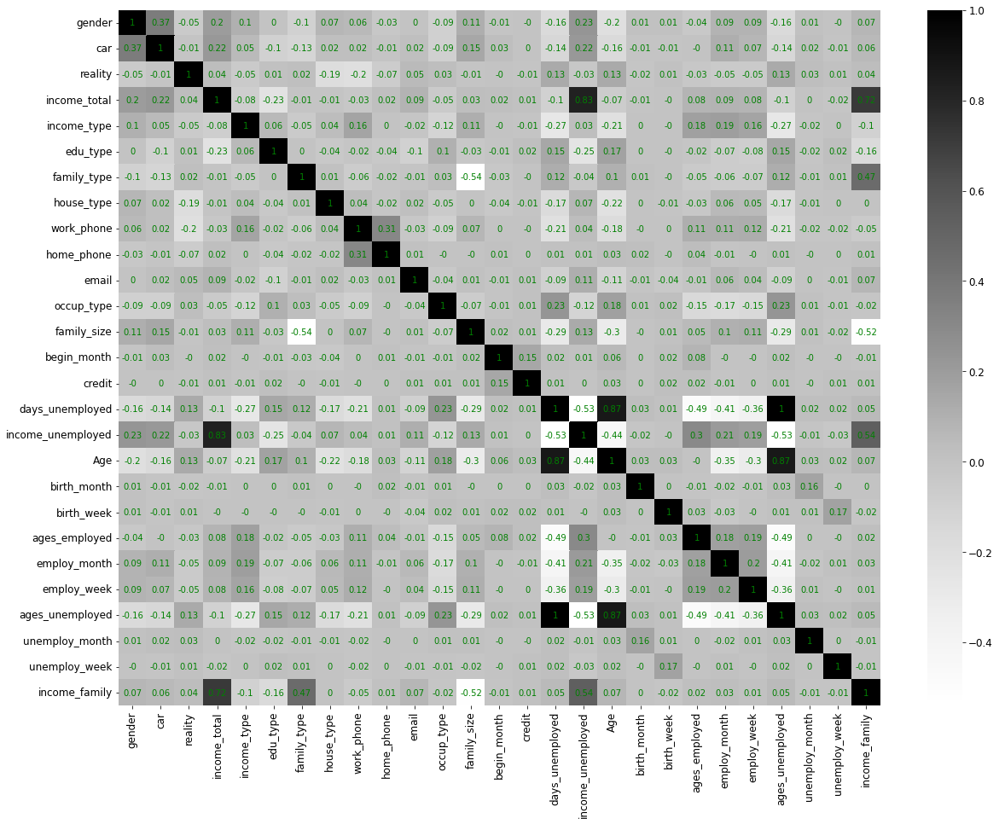

In [30]:
fig, ax = plt.subplots(figsize=(20,15))

ax = sns.heatmap(corr_df, annot=True, annot_kws=dict(color='g'), cmap='Greys')
plt.show()